# UNET


* Prepare image input
* Implement UNET
* Optimise the hyperparameters
* K-Fold validation

In [1]:
# Load libraries
%reload_ext autoreload
%autoreload 2
%matplotlib inline

from fastai.vision.all import *
import torch
from ipywidgets import IntProgress
from glob import glob
import numpy as np, pandas as pd, matplotlib.pyplot as plt
import cv2, os
from pathlib import Path
#from fastai.distributed import *
# always check if the GPUS are available - sometimes they come off for no reason
#torch.cuda.is_available()

In [3]:
%env TMPDIR=/scratch/pawsey0149/mmckay/fake_home

env: TMPDIR=/scratch/pawsey0149/mmckay/fake_home


In [4]:
pip install ipywidgets

Defaulting to user installation because normal site-packages is not writeable
  Using cached ipywidgets-8.1.1-py3-none-any.whl (139 kB)
  Using cached jupyterlab_widgets-3.0.9-py3-none-any.whl (214 kB)
  Using cached widgetsnbextension-4.0.9-py3-none-any.whl (2.3 MB)
  Using cached comm-0.1.4-py3-none-any.whl (6.6 kB)
You should consider upgrading via the '/opt/conda/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


# KFOLD

In [2]:
# functions for kfold and datablocks
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

def fname_folds(fold=0):
    def __inner(path, fold=0):
        fnames = get_image_files(path)
        from sklearn.model_selection import KFold
        kfold = KFold(n_splits=5, shuffle=True, random_state=33)
        kfold_ds = {}
        i=0
        for ti, vi in kfold.split(fnames):
            kfold_ds[i] = fnames[ti] + fnames[vi]
            i+=1
        return kfold_ds[fold]
    return __inner

def KfoldSplitter(valid_pct=0.2, seed=None): 
    def _inner(o):
        if seed is not None: torch.manual_seed(seed)
        rand_idx = L(list(torch.randperm(len(o)).numpy()))
        cut = int(valid_pct * len(o))
        return rand_idx[cut:], rand_idx[:cut]
    return _inner

# Testing for NA/broken values

In [37]:
#check for unique pixel values using np.unique
arrays = glob('/group/pawsey0149/mmckay/singularity/train_val_sets/*')
np.unique('/group/pawsey0149/mmckay/singularity/train_val_sets/IMG_0917_image.npy', return_index=True, return_inverse=False, return_counts=True, axis=None)


(array(['/group/pawsey0149/mmckay/singularity/train_val_sets/IMG_0917_image.npy'],
       dtype='<U70'),
 array([0]),
 array([1]))

In [41]:
#checking for nan values in numpy array
#will have to load all np arrays into single array and run test

arrays = glob('/group/pawsey0149/mmckay/singularity/train_val_sets/*')
array_complete = []
k = 0
for array in arrays:
    file = np.load(arrays[k])
    k+=1
array_complete.append(file)


In [43]:
np.shape(array_complete)

(1, 4032, 3024)

In [47]:
#not a number test,
#undefined or empty indexes
np.isnan(array_complete, where=True).all()

False

# Model Tests


In [2]:
codes = np.loadtxt("/scratch/pawsey0149/mmckay/codes.txt", dtype='str')
path = Path('/scratch/pawsey0149/mmckay/training_set/')

In [3]:
print(path)

/scratch/pawsey0149/mmckay/training_set


In [4]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [5]:
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=RandomSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= [*aug_transforms(do_flip=True, flip_vert=True,
                 max_rotate=30.0, min_zoom=1.0,
                 max_zoom=1.5, max_lighting=0.5,
                 max_warp=0.2, p_affine=0.75,
                 p_lighting=0.75, xtra_tfms=None,
                 size = 224, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=False,
                 min_scale=1.0)])

/opt/conda/lib/python3.7/site-packages/torch/cuda/__init__.py:80: UserWarning: HIP initialization: Unexpected error from hipGetDeviceCount(). Did you run some cuda functions before calling NumHipDevices() that might have already set an error? Error 101: hipErrorInvalidDevice (Triggered internally at  /var/lib/jenkins/pytorch/c10/hip/HIPFunctions.cpp:113.)
  return torch._C._cuda_getDeviceCount() > 0


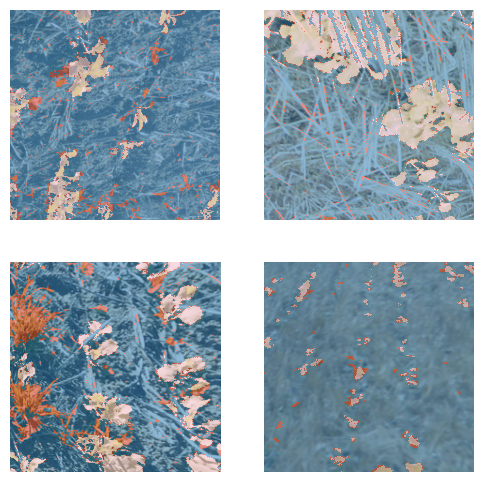

In [6]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [7]:
# loss function could be Diceloss (most used), Focal loss (ensures low class imbalance)
# Introduced calback whichg tracks data run into learner
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy(),
                     opt_func=Adam,
                     lr= 0.001,
                     wd=None,
                     #cbs=ActivationStats(with_hist=True),
                     metrics=[DiceMulti, JaccardCoeff]).to_fp16()
# is unet pretrained? tune hyperparameters

In [ ]:
#fine_tune = gradual learning rate warmup, and a gradual learning rate cooldown
#jumping to a high learning rate is more likely to result in diverging losses
learn.fine_tune(300, 0.001)

/opt/conda/lib/python3.7/site-packages/torch/autocast_mode.py:141: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
/opt/conda/lib/python3.7/site-packages/torch/cuda/amp/grad_scaler.py:115: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  warnings.warn("torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.")


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time


In [25]:
lr_min1,lr_steep1 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR before training {lr_steep1}")
learn.fine_tune(300, lr_steep1)
    
lr_min2,lr_steep2 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR after defreezing {lr_steep2}")
    
learn.unfreeze()
learn.fine_tune(300,
    lr_max=slice(lr_steep2, lr_steep1), 
    cbs=CSVLogger(fname='unet18_kfold_pretrained', append=True))


LR before training 1.3182567499825382e-06


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,1.458281,1.449747,0.153490,0.977157,07:43


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,1.443594,1.460192,0.147427,0.956198,08:06
1,1.452219,1.462213,0.151934,0.966576,08:03
2,1.436086,1.458537,0.149328,0.960820,08:05
3,1.435991,1.458502,0.149251,0.957808,08:05
4,1.425566,1.455281,0.149627,0.961712,08:06
5,1.429279,1.468389,0.146638,0.954633,08:05
6,1.441038,1.463189,0.148062,0.954486,08:03
7,1.436195,1.455781,0.149627,0.962743,08:03
8,1.432096,1.457757,0.149056,0.962171,08:06
9,1.428764,1.448944,0.149317,0.956720,08:04


KeyboardInterrupt: 

In [13]:
lr_max


NameError: name 'lr_max' is not defined

In [74]:
learn.activation_stats.plot_layer_stats(0)

AttributeError: 'DynamicUnet' object has no attribute 'activation_stats'

RuntimeError: number of dims don't match in permute

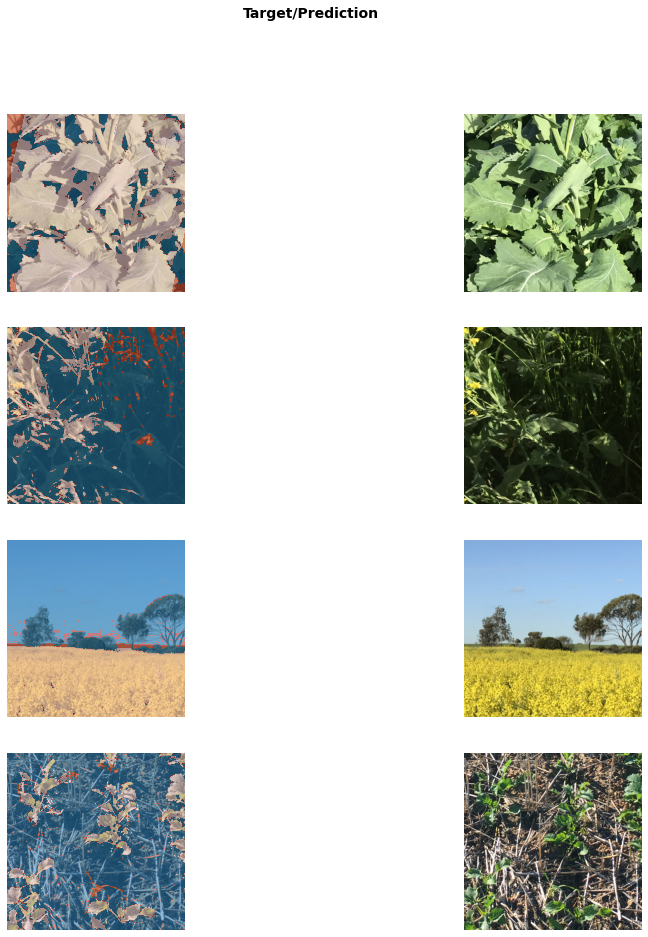

In [14]:
learn.show_results(max_n=4, figsize=(15,15))

RuntimeError: number of dims don't match in permute

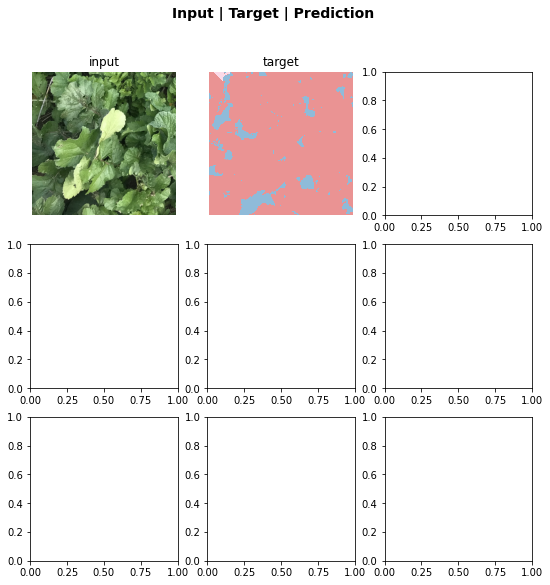

In [15]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=3)

In [50]:
# Disable Fastai progress bar

lr_min1,lr_steep1 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR before training {lr_steep1}")
learn.fit_one_cycle(1, lr_steep1)
    
lr_min2,lr_steep2 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR after defreezing {lr_steep2}")
    
learn.unfreeze()
learn.fit_one_cycle(2,
    lr_max= slice(lr_steep2, lr_steep1), 
    cbs=CSVLogger(fname='unet18_kfold_pretrained', append=True))

LR before training 0.002511886414140463


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,accuracy_multi,time


AssertionError: Exception occured in `Recorder` when calling event `after_batch`:
	==:
3000000
1000000

# Model 2

In [3]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [4]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [5]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=[*aug_transforms(size=500, min_scale=0.75),
                               Normalize.from_stats(*imagenet_stats)])

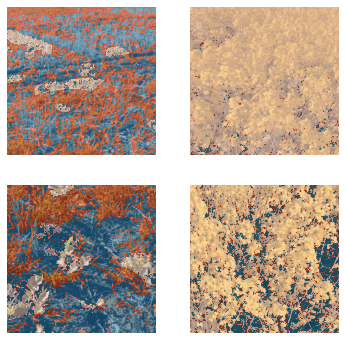

In [30]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [31]:
# default eps is 0.1
# maybe could try cbs=MixUp()
# can get rid of *aug_transforms(size=500, min_scale=0.75) in datablock
# half precision fp_16 can increase performance however can cause divergence of model
# could try removing it
# may also result in lower precision
#https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy (eps=0.01, weight=None,reduction='mean'),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     #cbs=ActivationStats(with_hist=True),
                     metrics=[DiceMulti, JaccardCoeff]).to_fp16()
# is unet pretrained? tune hyperparameters

In [25]:
learn.fit_one_cycle(300, 3e-3)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.429606,0.360146,0.757472,7.452003,08:09
1,0.364270,0.310786,0.793007,8.424719,08:16
2,0.343596,0.325531,0.800593,6.368404,08:22
3,0.330222,0.298979,0.824329,8.322403,08:23
4,0.307605,0.313990,0.829799,6.953689,08:24
5,0.316053,0.279920,0.829681,7.612631,08:25
6,0.299875,0.267275,0.840971,9.000559,08:22
7,0.300248,0.272801,0.849419,7.972912,08:34
8,0.312682,0.276319,0.813877,8.975418,08:26
9,0.283417,nan,0.837761,7.971564,08:23


KeyboardInterrupt: 

In [33]:
learn.fine_tune(300, 0.001)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.335118,0.318888,0.821611,6.730927,08:22


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.307108,0.272090,0.842795,8.587200,08:44


KeyboardInterrupt: 

In [ ]:
learn.show_results(max_n=4, figsize=(15,15))

In [ ]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=3)

# Model 3

In [37]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [38]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [39]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

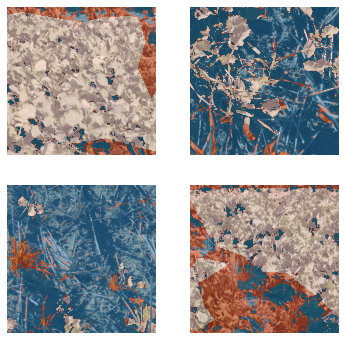

In [40]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [41]:
# default eps is 0.1
# maybe could try cbs=MixUp()
# can get rid of *aug_transforms(size=500, min_scale=0.75) in datablock
# half precision fp_16 can increase performance however can cause divergence of model
# could try removing it
# may also result in lower precision
#https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy (eps=0.1, weight=None,reduction='mean'),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     #cbs=ActivationStats(with_hist=True),
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [42]:
learn.fine_tune(300, 0.001)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.873475,0.844819,0.491521,2.257722,07:42


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.831765,0.805236,0.518514,2.994102,08:07
1,0.818286,0.789106,0.534323,3.652090,08:07
2,0.793788,0.776972,0.540632,3.890326,08:05
3,0.783636,0.767867,0.550699,4.055154,08:05
4,0.785030,0.760719,0.554993,4.371923,08:09
5,0.784608,0.762013,0.554209,4.178691,08:06
6,0.787251,0.781434,0.543100,3.989827,08:06
7,0.795461,0.751458,0.562209,4.191176,08:07
8,0.798575,0.753041,0.567150,4.516711,08:07
9,0.799092,0.758527,0.561760,4.317223,08:06


KeyboardInterrupt: 

In [43]:
learn.show_results(max_n=4, figsize=(8,8))

RuntimeError: "softmax_lastdim_kernel_impl" not implemented for 'Half'

In [44]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=3)

RuntimeError: "softmax_lastdim_kernel_impl" not implemented for 'Half'

# Model 4

In [53]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [54]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [55]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=Normalize)

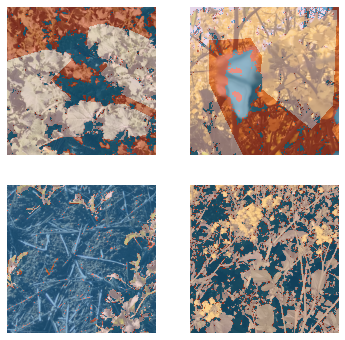

In [56]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [64]:
# default eps is 0.1
# maybe could try cbs=MixUp()
# half precision fp_16 can increase performance however can cause divergence of model
# could try removing it
# may also result in lower precision
# https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy (eps=0.1, weight=None,reduction='mean'),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [63]:
lr_min1,lr_steep1 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR before training {lr_steep1}")
learn.fine_tune(300, lr_steep1)
    
lr_min2,lr_steep2 = learn.lr_find(suggest_funcs=(minimum, steep), show_plot=False)
print(f"LR after defreezing {lr_steep2}")
    
learn.unfreeze()
learn.fine_tune(300,
    lr_max=slice(lr_steep2, lr_steep1), 
    cbs=CSVLogger(fname='unet18_kfold_pretrained', append=True))

LR before training 7.585775847473997e-07


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time


KeyboardInterrupt: 

SuggestedLRs(valley=0.02754228748381138)

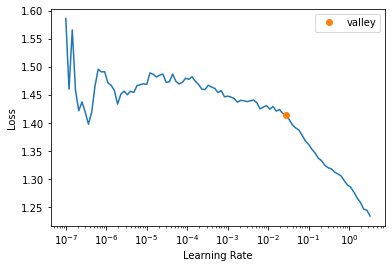

In [65]:
learn.lr_find()

In [ ]:
learn.fine_tune(300, 0.0275)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,1.171984,1.277127,0.509639,2.969187,07:39


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,1.794455,1.741868,0.631593,3.681498,07:56
1,2.527879,nan,0.621300,4.112233,08:00
2,nan,nan,0.223085,0.000000,07:55
3,nan,nan,0.223085,0.000000,07:55
4,nan,nan,0.223085,0.000000,07:54
5,nan,nan,0.223085,0.000000,07:55
6,nan,nan,0.223085,0.000000,07:50
7,nan,nan,0.223085,0.000000,07:51
8,nan,nan,0.223085,0.000000,07:53
9,nan,nan,0.223085,0.000000,07:54


# Model 5

In [14]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [15]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [16]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=Normalize)

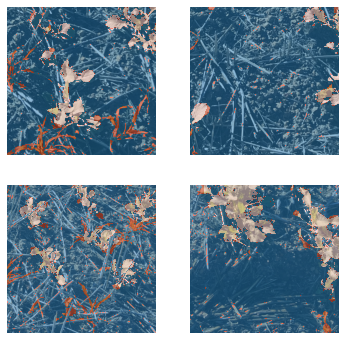

In [17]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [26]:
# default eps is 0.1
# maybe could try cbs=MixUp()
# traling RMSProp
# https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy (eps=0.1, weight=None,reduction='mean'),
                     opt_func=RMSProp,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [ ]:
learn.fine_tune(300, 0.001)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.617494,0.524393,0.662184,9.391684,07:34


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.483527,0.467211,0.829287,8.048734,07:36
1,0.461913,0.447522,0.856227,8.740708,07:44
2,0.439504,0.449343,0.856028,8.454238,07:53
3,0.445317,0.431737,0.863065,9.596064,07:47
4,0.429711,0.429460,0.870921,8.884051,07:49
5,0.408607,0.438351,0.863168,9.190426,07:44
6,0.412869,0.425381,0.871683,9.725182,07:48
7,0.401972,0.427268,0.873720,8.535442,07:51
8,0.402296,0.422847,0.873910,9.182865,07:49
9,0.406009,0.421775,0.877312,9.218116,07:51


# Model 6

In [4]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [5]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [6]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=Normalize)

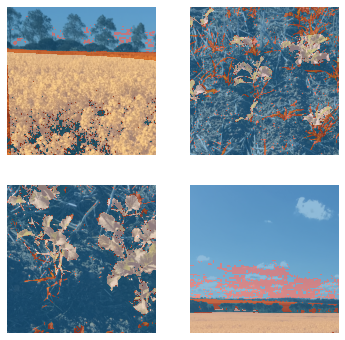

In [8]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [9]:
# default eps is 0.1
# maybe could try cbs=MixUp()
#increased lr
#trialing Larc optimizer
# https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy (eps=0.1, weight=None,reduction='mean'),
                     opt_func=Larc,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [ ]:
learn.fine_tune(300, 0.002)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.648885,0.578123,0.617556,7.818478,07:51


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.612994,0.564937,0.629096,8.156746,08:04
1,0.598262,0.558198,0.655822,8.057513,08:06
2,0.587227,0.551092,0.693834,7.508839,08:05
3,0.588828,0.551474,0.712680,6.775935,08:05
4,0.571350,0.538262,0.721338,7.977976,08:00
5,0.546049,0.531712,0.738960,7.759043,08:00
6,0.545785,0.526215,0.742923,8.060902,07:58
7,0.565454,0.521255,0.774189,7.425311,08:06
8,0.549589,0.516314,0.787642,7.202258,08:04
9,0.522070,0.518572,0.755898,8.441116,08:06


# Model 7

In [2]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [3]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [4]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=(Normalize,))

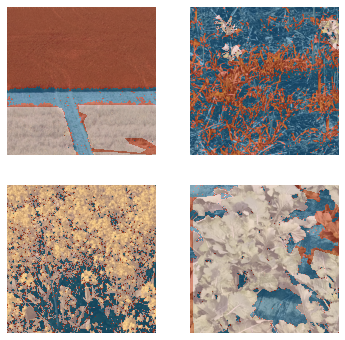

In [5]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [6]:
# default eps is 0.1
# maybe could try cbs=MixUp()
#increased lr
#trialing Larc optimizer
# https://forums.fast.ai/t/mixed-precision-training/20720/14
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [7]:
learn.fine_tune(300, 0.002)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.823562,3.646965,0.730094,8.641420,07:47


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,2.835208,2.725810,0.836819,8.933489,08:04
1,2.718415,2.593709,0.855834,8.421756,07:56
2,2.561984,2.532631,0.858838,9.090302,07:55
3,2.417055,2.589409,0.862716,8.574583,07:58
4,2.411940,2.352194,0.870594,9.187658,07:51
5,2.234588,2.392773,0.870562,9.012088,07:52
6,2.118663,2.333518,0.870607,9.164893,08:01
7,2.046018,2.298272,0.873996,9.393927,07:51
8,2.035770,2.307705,0.874435,9.300792,07:51
9,1.947076,2.324629,0.875516,8.355564,07:52


KeyboardInterrupt: 

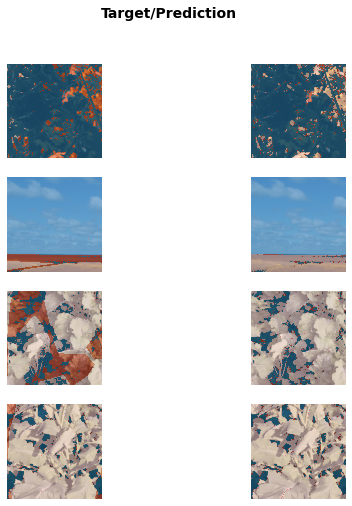

In [8]:
learn.show_results(max_n=4, figsize=(8,8))

# Model 8

In [2]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [3]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [4]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                batch_tfms=[*aug_transforms(size=500, min_scale=0.75),
                               Normalize])

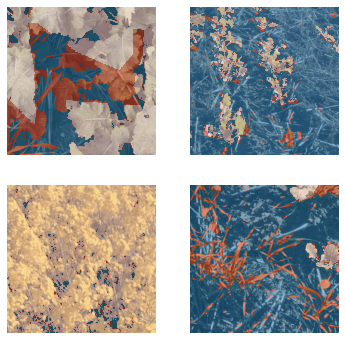

In [5]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [6]:
# default eps is 0.1
# maybe could try cbs=MixUp()
#increased lr
#removed drone images for this run
#unfreezing and fine-tuning the whole model a bit more with discriminative learning rates 
#(that is: a lower learning rate for the body and a higher one for the head):
#NEXT MODEL TRY AUGMENTATION
learn = unet_learner(dls, 
                     resnet34,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters

In [ ]:
learn.fit_one_cycle(20, 0.002)
learn.unfreeze()
learn.fit_one_cycle(300, slice(1e-5,1e-3),
cbs=CSVLogger(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_1', append=True))

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.371860,3.930020,0.756610,7.916068,07:34
1,3.936803,3.954551,0.759644,5.186711,07:28
2,3.804182,3.271815,0.785624,8.620700,07:28
3,3.679063,3.147504,0.803616,7.775017,07:29
4,3.529197,3.135208,0.796684,8.258949,07:24
5,3.458039,3.034445,0.807878,6.963260,07:24
6,3.861104,3.478142,0.786138,7.258786,07:20
7,3.387886,3.032521,0.812050,8.529734,07:20
8,3.200895,3.220702,0.797631,6.574921,07:23
9,3.306320,3.076373,0.814280,6.936154,07:28


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,2.995334,2.687930,0.837213,7.793786,07:39
1,2.983921,2.719598,0.835823,7.428212,07:48
2,2.886037,2.733266,0.834315,7.337354,07:43
3,2.995551,2.693571,0.839282,7.761759,07:44
4,2.890843,2.695399,0.839218,7.906631,07:42
5,2.895803,2.670329,0.841479,8.183929,07:45
6,3.024630,2.671977,0.840543,7.953543,07:41
7,2.961050,2.666050,0.838933,8.338533,07:42
8,2.986874,2.688480,0.837659,7.914467,07:40
9,2.937789,2.700182,0.836588,7.862443,07:43


In [ ]:
learn.save('/data/weed_data/model_weights/unet18_1fold', 
                 with_opt=True,
                 pickle_protocol=2)

In [ ]:
learn.export(fname='/data/weed_data/model_weights/unet18_1fold_export.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

# Model 9

In [12]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [13]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [14]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=[Normalize])

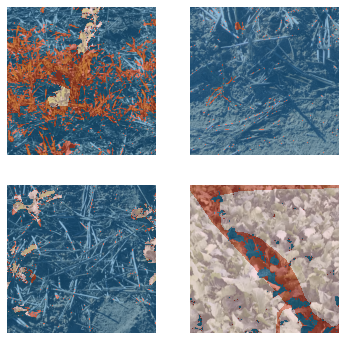

In [15]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [16]:
# default eps is 0.1
# maybe could try cbs=MixUp()
#increased lr
#removed drone images for this run
#unfreezing and fine-tuning the whole model a bit more with discriminative learning rates 
#(that is: a lower learning rate for the body and a higher one for the head):
#introduced augmentation
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=LabelSmoothingCrossEntropy(),
                     opt_func=RMSProp,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters\
#have to use fine_tune as error skyrockets with fit_one_cycle

In [13]:
learn.fine_tune(20, 0.001)
learn.unfreeze()
learn.fit_one_cycle(300, slice(1e-5,1e-3),
cbs=CSVLogger(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_1', append=True))

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,7.184952,0.560121,0.645280,7.816362,07:15


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.506310,0.489700,0.794952,9.149799,07:47
1,0.492500,0.480853,0.813031,9.101996,07:28
2,0.494012,0.476050,0.808762,9.638982,07:43
3,0.487003,0.470917,0.833681,8.864543,07:39
4,0.478316,0.493087,0.745227,10.012197,07:41
5,0.495158,0.535838,0.792402,6.269898,07:41
6,0.477034,0.472202,0.825636,8.288507,07:41
7,0.462296,0.469356,0.831851,9.448627,07:43
8,0.467489,0.455886,0.842601,9.730069,07:39
9,0.459801,0.458066,0.840747,9.143213,07:40


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,0.440522,0.459624,0.843599,8.959978,07:27
1,0.435511,0.453986,0.847361,9.134031,07:27
2,0.434991,0.455554,0.847880,9.003644,07:30
3,0.435693,0.457448,0.847971,8.951320,07:32
4,0.426981,0.455804,0.845942,9.341989,07:35
5,0.434893,0.457023,0.843599,9.195299,07:36
6,0.429692,0.459847,0.844368,8.765017,07:28
7,0.425162,0.458203,0.843844,9.207477,07:29
8,0.428140,0.456538,0.845886,9.598393,07:26
9,0.429951,0.459641,0.846441,8.927756,07:29


KeyboardInterrupt: 

In [27]:
help(learn.fine_tune)

Help on method fine_tune in module fastai.callback.schedule:

fine_tune(epochs, base_lr=0.002, freeze_epochs=1, lr_mult=100, pct_start=0.3, div=5.0, *, lr_max=None, div_final=100000.0, wd=None, moms=None, cbs=None, reset_opt=False, start_epoch=0) method of fastai.learner.Learner instance
    Fine tune with `Learner.freeze` for `freeze_epochs`, then with `Learner.unfreeze` for `epochs`, using discriminative LR.



# Model 10 resnet34 with Augmentation

In [50]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [51]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [52]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms= [*aug_transforms(do_flip=True, flip_vert=True,
                 max_rotate=10.0, min_zoom=1.0,
                 max_zoom=1.5, max_lighting=0.2,
                 max_warp=0.2, p_affine=0.75,
                 p_lighting=0.75, xtra_tfms=None,
                 size = 500, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=False,
                 min_scale=1.0)])

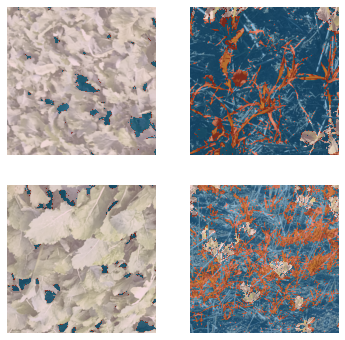

In [53]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [54]:
learn = unet_learner(dls, 
                     resnet34,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()


In [55]:
learn.fine_tune(300, 0.001)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.366249,3.703402,0.777942,4.404786,04:15


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.760865,3.093516,0.809455,5.167081,04:30
1,3.440423,3.093023,0.820113,5.119829,04:23


KeyboardInterrupt: 

# Model 11 Resnet18 no augmentation

In [90]:
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/')

In [13]:
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [14]:
#introduced batch normalization and aug transform
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items = get_image_files,
                   get_y = label_func,
                   splitter=RandomSplitter(valid_pct=0.2, seed=100),
                   batch_tfms=(Normalize,))

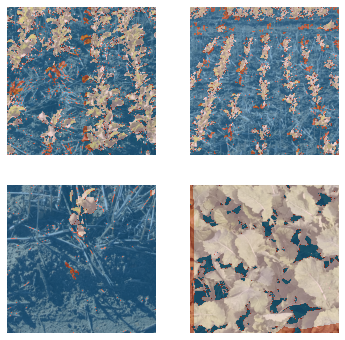

In [15]:
dls = weedt.dataloaders(path/"images", path=path, bs=4)
dls.show_batch(max_n=4)

In [16]:
# default eps is 0.1
# maybe could try cbs=MixUp()
#increased lr
#removed drone images for this run
#unfreezing and fine-tuning the whole model a bit more with discriminative learning rates 
#(that is: a lower learning rate for the body and a higher one for the head):
#introduced augmentation
learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()
# is unet pretrained? tune hyperparameters\
#have to use fine_tune as error skyrockets with fit_one_cycle

In [7]:
learn.fine_tune(300, 0.001)
cbs=CSVLogger(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_4', append=True)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.889226,3.360139,0.786847,5.946527,03:42


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.159420,2.852355,0.823212,5.204484,03:37
1,2.978250,2.808751,0.831311,5.142421,03:37
2,2.773569,2.636769,0.844103,5.618097,03:37
3,2.629872,2.660056,0.841341,5.532505,03:37
4,2.519190,2.542031,0.850648,6.044754,03:37
5,2.361323,2.484190,0.852937,5.832755,03:37
6,2.260789,2.499515,0.852590,5.809362,03:37
7,2.051212,2.388785,0.858287,5.774689,03:38
8,2.008273,2.398778,0.860569,6.263174,03:38
9,2.008946,2.381435,0.859708,6.488886,03:38


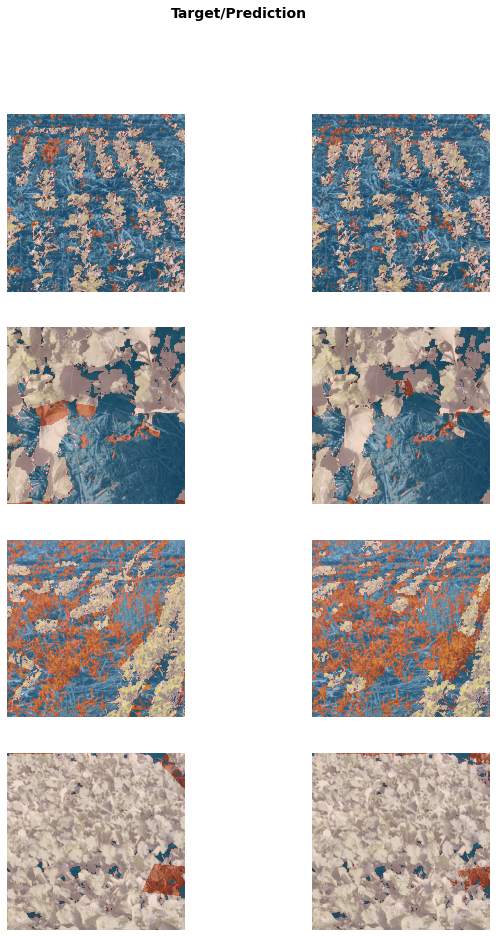

In [18]:
learn.show_results(max_n=10, figsize=(10,15))

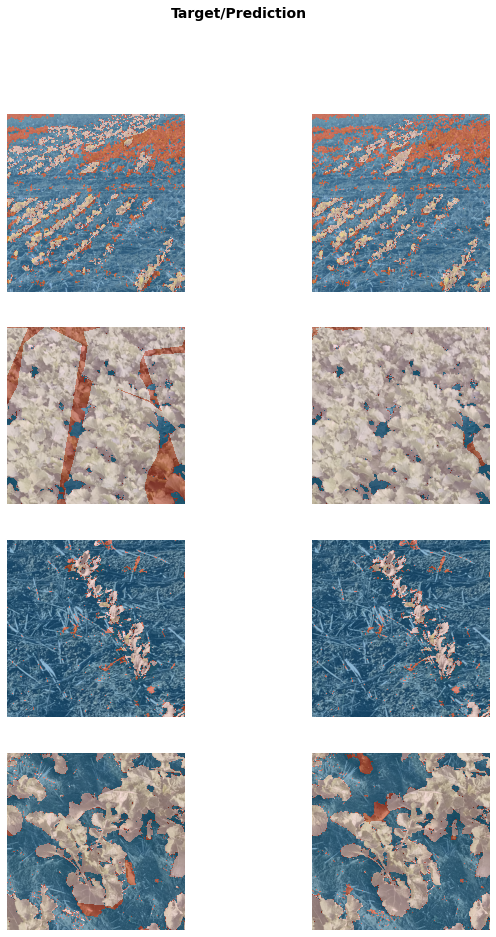

In [20]:
learn.show_results(max_n=10, figsize=(10,15))

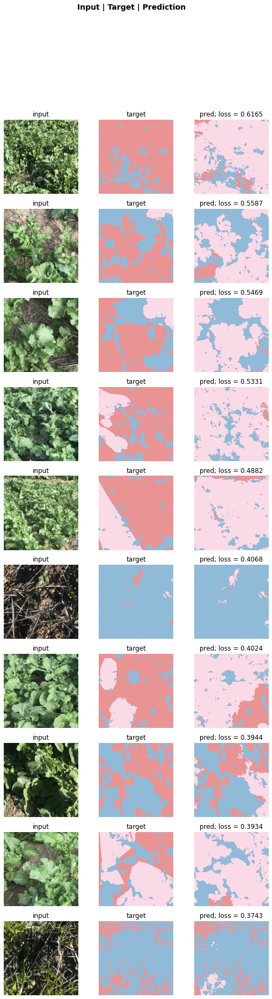

In [19]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

In [12]:
learn.save('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_3', 
                 with_opt=True,
                 pickle_protocol=2)

Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_3.pth')

In [13]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_3_export.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

In [20]:
learn = load_learner(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_3_export.pkl')

# KFOLD - 5-fold-val Resnet18 no augmentation

In [2]:
# functions for kfold and datablocks
def label_func(fn): 
    return path/"labels"/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

def fname_folds(fold=0):
    def __inner(path, fold=0):
        fnames = get_image_files(path)
        from sklearn.model_selection import KFold
        kfold = KFold(n_splits=5, shuffle=True, random_state=33)
        kfold_ds = {}
        i=0
        for ti, vi in kfold.split(fnames):
            kfold_ds[i] = fnames[ti] + fnames[vi]
            i+=1
        return kfold_ds[fold]
    return __inner

def KfoldSplitter(valid_pct=0.2, seed=None): 
    def _inner(o):
        if seed is not None: torch.manual_seed(seed)
        rand_idx = L(list(torch.randperm(len(o)).numpy()))
        cut = int(valid_pct * len(o))
        return rand_idx[cut:], rand_idx[:cut]
    return _inner

In [5]:
fnames = glob('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/*')
fnames = np.array(fnames)
from sklearn.model_selection import KFold
kfold = KFold(n_splits=5, shuffle=True, random_state=33)
kfold_ds = {}
i=0

for ti, vi in kfold.split(fnames):
    kfold_ds[i] = np.concatenate((fnames[ti], fnames[vi]))
    i+=1
    
kfold_ds

{0: array(['/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/Cund_T1_4007_image_9.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/D3t1_image_11.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/Cund_T1_2001_image_0.png',
        ...,
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/F10t2_image_8.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/A5t2_image_11.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/C8t2_image_11.png'],
       dtype='<U88'),
 1: array(['/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/Cund_T1_4007_image_9.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/D3t1_image_11.png',
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/Cund_T1_2001_image_0.png',
        ...,
        '/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images/D7t1_image_3.png'

In [6]:
import os
import shutil

# Define output directory
output_dir = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/"

# Loop through each split and save its contents in a separate folder
for split_num, split_data in kfold_ds.items():
    split_dir = os.path.join(output_dir, f"{split_num}/")
    os.makedirs(split_dir, exist_ok=True)
    for file_path in split_data:
        file_name = os.path.basename(file_path)
        output_file_path = os.path.join(split_dir, file_name)
        shutil.copyfile(file_path, output_file_path)

In [39]:
#load in saved model
#learn = load_learner(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/models/unet18_3_export.pkl')

In [3]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [6]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms=Normalize)

# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=5)
    
    learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.001,
                    fname='unet_18_kfold', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/"
    with open(f"{path}unet18_kfold.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.510677,3.213948,0.848909,5.895443,17:57


Better model found at epoch 0 with dice_multi value: 0.8489090458572021.


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,2.684553,2.608608,0.883852,6.359243,18:22
1,2.351367,2.336948,0.897293,6.716582,18:24
2,2.136005,2.145873,0.907148,6.699509,18:23
3,1.992765,2.024753,0.913840,6.744028,18:27
4,1.911032,1.900364,0.920193,6.608248,18:05
5,1.787806,1.767247,0.926754,6.764002,18:13
6,1.606886,1.622411,0.933808,6.834604,18:20
7,1.496648,1.560031,0.937880,7.005525,18:21
8,1.456166,1.489718,0.941112,7.059637,18:25
9,1.414096,1.413137,0.944288,6.963728,18:24


Better model found at epoch 0 with dice_multi value: 0.8838520248220769.
Better model found at epoch 1 with dice_multi value: 0.8972926211449175.
Better model found at epoch 2 with dice_multi value: 0.907148157948447.
Better model found at epoch 3 with dice_multi value: 0.9138397502850798.
Better model found at epoch 4 with dice_multi value: 0.9201934386359675.
Better model found at epoch 5 with dice_multi value: 0.9267536246277791.
Better model found at epoch 6 with dice_multi value: 0.9338076893019709.
Better model found at epoch 7 with dice_multi value: 0.93787994370064.
Better model found at epoch 8 with dice_multi value: 0.9411119944159295.
Better model found at epoch 9 with dice_multi value: 0.9442883836526309.
Better model found at epoch 10 with dice_multi value: 0.9480759608199678.
Better model found at epoch 11 with dice_multi value: 0.9522025324842138.
Better model found at epoch 12 with dice_multi value: 0.9537287710102426.
Better model found at epoch 13 with dice_multi valu

In [7]:
with open(f"{path}unet18_kfold.txt", "wb") as ot:
         pickle.dump(results, ot)

In [8]:
with open(f"{path}unet18_kfold.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [0.754970908164978],
 'dice': [0.9733737740760088],
 'iou': [7.358783511662038]}

In [9]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/unet18_kfold.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

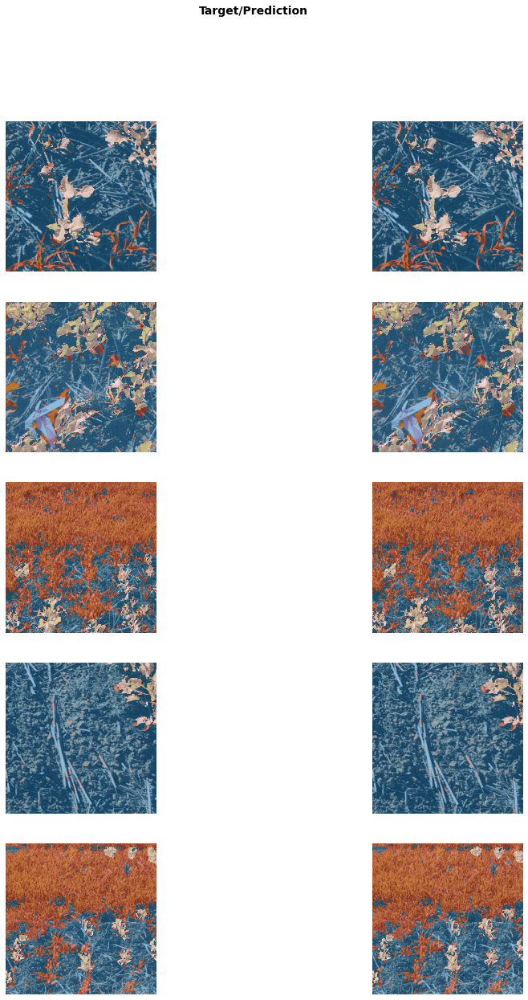

In [26]:
learn.show_results(max_n=10, figsize=(15,20))

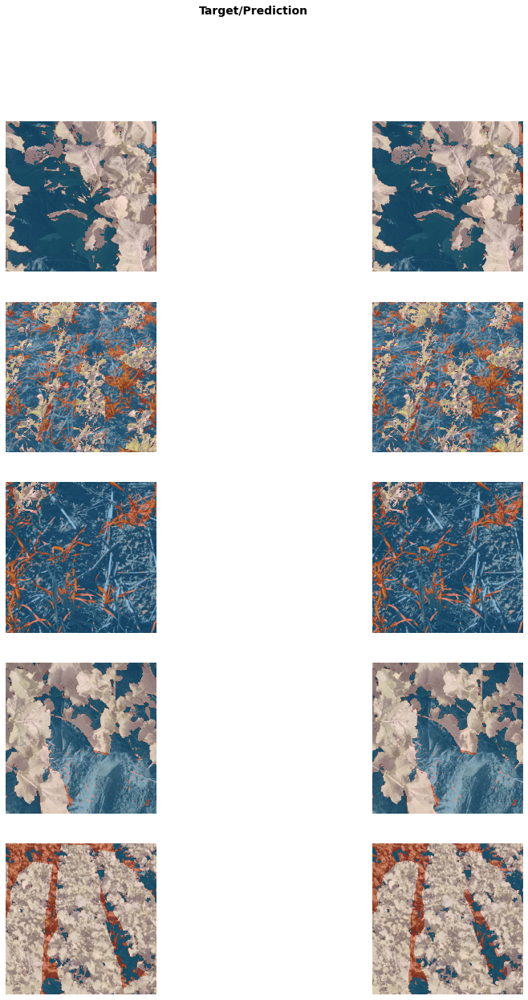

In [27]:
learn.show_results(max_n=10, figsize=(15,20))

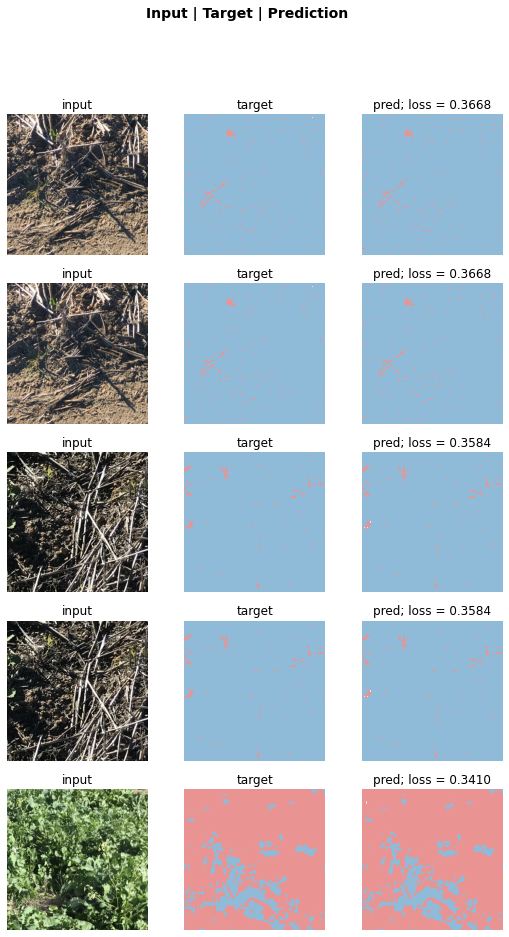

In [10]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=5)

# KFOLD - 5-fold-val Resnet18 augmentation

In [11]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [ ]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= [*aug_transforms(do_flip=True, flip_vert=True,
                 max_rotate=30.0, min_zoom=1.0,
                 max_zoom=1.5, max_lighting=0.5,
                 max_warp=0.2, p_affine=0.75,
                 p_lighting=0.75, xtra_tfms=None,
                 size = 500, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=False,
                 min_scale=1.0)])

# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=5)
    
    learn = unet_learner(dls, 
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                    fname='unet18_kfold_aug', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold"
    with open(f"{path}unet18_kfold_aug.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.643513,3.982836,0.801291,5.235533,18:44


Better model found at epoch 0 with dice_multi value: 0.801290536475384.


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.095504,3.610930,0.828128,5.099314,19:12
1,4.062933,3.433519,0.839221,5.463608,19:15
2,3.923804,3.345838,0.841197,5.272148,19:31
3,3.881782,3.312407,0.847315,5.438132,19:23
4,3.707807,3.312897,0.841733,5.200177,19:27
5,3.672482,3.203571,0.849786,5.619247,19:16
6,3.513172,3.252280,0.853518,5.521156,19:26
7,3.630679,3.136292,0.857185,5.783251,19:29
8,3.522307,3.055617,0.858239,5.723923,19:19
9,3.449505,3.072736,0.860174,5.832173,19:20


Better model found at epoch 0 with dice_multi value: 0.8281275902324653.
Better model found at epoch 1 with dice_multi value: 0.8392213695491403.
Better model found at epoch 2 with dice_multi value: 0.8411965968837315.
Better model found at epoch 3 with dice_multi value: 0.8473145661359481.
Better model found at epoch 5 with dice_multi value: 0.8497855765289968.
Better model found at epoch 6 with dice_multi value: 0.8535183002677361.
Better model found at epoch 7 with dice_multi value: 0.8571845463789.
Better model found at epoch 8 with dice_multi value: 0.8582390028630061.
Better model found at epoch 9 with dice_multi value: 0.8601735047913172.
Better model found at epoch 11 with dice_multi value: 0.8667712466261661.
Better model found at epoch 13 with dice_multi value: 0.8726422109404015.
No improvement since epoch 13: early stopping


In [8]:
with open(f"{path}unet18_kfold_aug.txt", "wb") as ot:
         pickle.dump(results, ot)

In [9]:
with open(f"{path}unet18_kfold_aug.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [2.7840957641601562],
 'dice': [0.8763404800745812],
 'iou': [5.474559951129374]}

In [10]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/unet18_kfold_aug.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

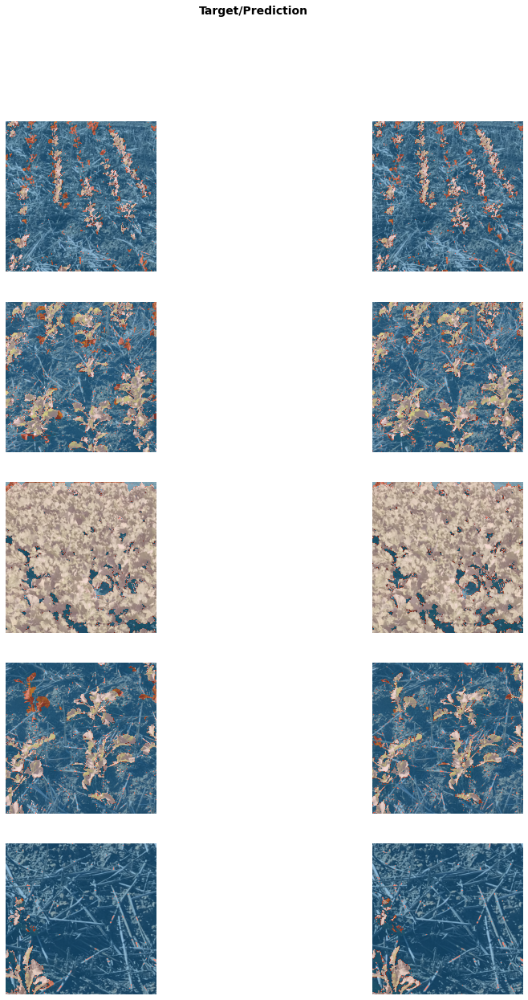

In [12]:
learn.show_results(max_n=10, figsize=(15,20))

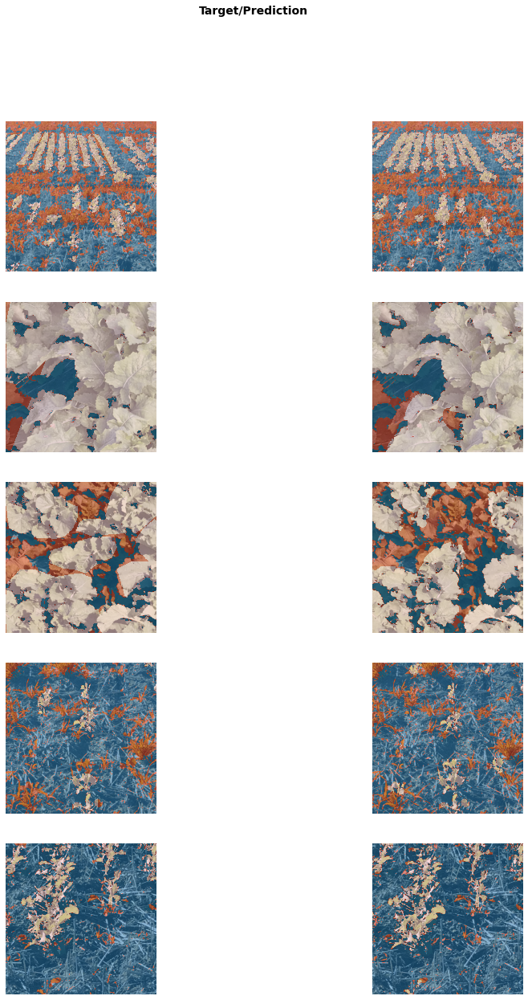

In [13]:
learn.show_results(max_n=10, figsize=(15,20))

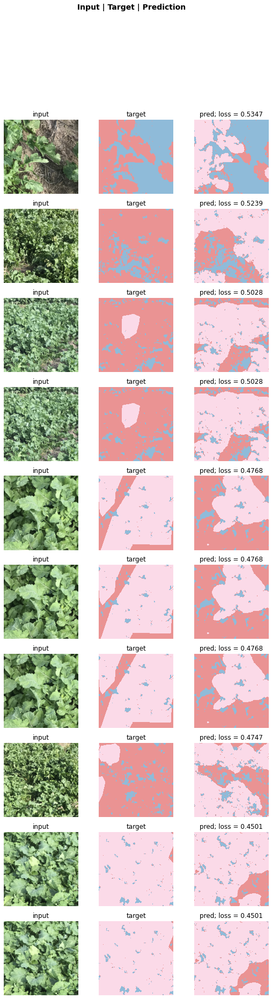

In [14]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

# KFOLD - 5-fold-val Resnet34 

In [3]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [4]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= Normalize)

# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=5)
    
    learn = unet_learner(dls, 
                     resnet34,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                    fname='unet_34_kfold', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold"
    with open(f"{path}unet34_kfold.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.174747,3.116288,0.849062,6.134392,18:55


Better model found at epoch 0 with dice_multi value: 0.8490618095207308.


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,2.501239,2.481977,0.888188,6.288930,19:23
1,2.275917,2.210561,0.905536,6.619312,19:18
2,2.006253,2.025643,0.915186,6.802336,19:12
3,1.886197,1.905400,0.921623,6.930351,19:11
4,1.767813,1.723903,0.928564,6.672427,19:24
5,1.640555,1.582625,0.935643,6.788046,19:30
6,1.473493,1.463387,0.942543,6.898114,19:30
7,1.389377,1.390089,0.946190,6.936063,19:33
8,1.310697,1.298362,0.949305,6.985335,19:38
9,1.220906,1.236865,0.952521,7.144624,19:38


Better model found at epoch 0 with dice_multi value: 0.888187888071497.
Better model found at epoch 1 with dice_multi value: 0.9055360075930182.
Better model found at epoch 2 with dice_multi value: 0.915185761379055.
Better model found at epoch 3 with dice_multi value: 0.9216225136546915.
Better model found at epoch 4 with dice_multi value: 0.9285637681540088.
Better model found at epoch 5 with dice_multi value: 0.9356432688147507.
Better model found at epoch 6 with dice_multi value: 0.9425426152522723.
Better model found at epoch 7 with dice_multi value: 0.946189749514868.
Better model found at epoch 8 with dice_multi value: 0.9493051280329109.
Better model found at epoch 9 with dice_multi value: 0.952521012521049.
Better model found at epoch 10 with dice_multi value: 0.9559403609336572.
Better model found at epoch 11 with dice_multi value: 0.9579979264584728.
Better model found at epoch 12 with dice_multi value: 0.9600998985307561.
Better model found at epoch 13 with dice_multi value

In [5]:
with open(f"{path}unet34_kfold.txt", "wb") as ot:
         pickle.dump(results, ot)

In [6]:
with open(f"{path}unet34_kfold.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [0.7102146148681641],
 'dice': [0.9749791289036399],
 'iou': [7.415425060283881]}

In [7]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/resnet34_kfold.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

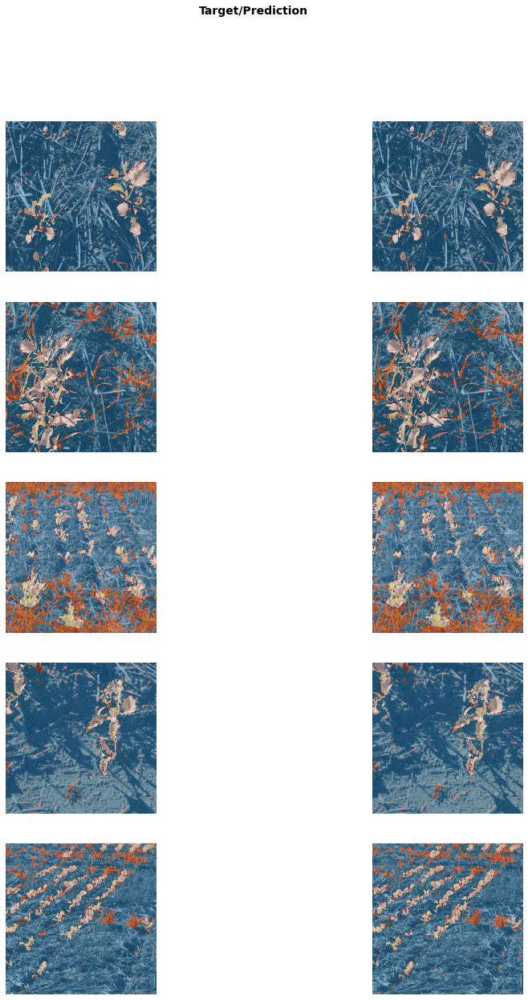

In [8]:
learn.show_results(max_n=10, figsize=(15,20))

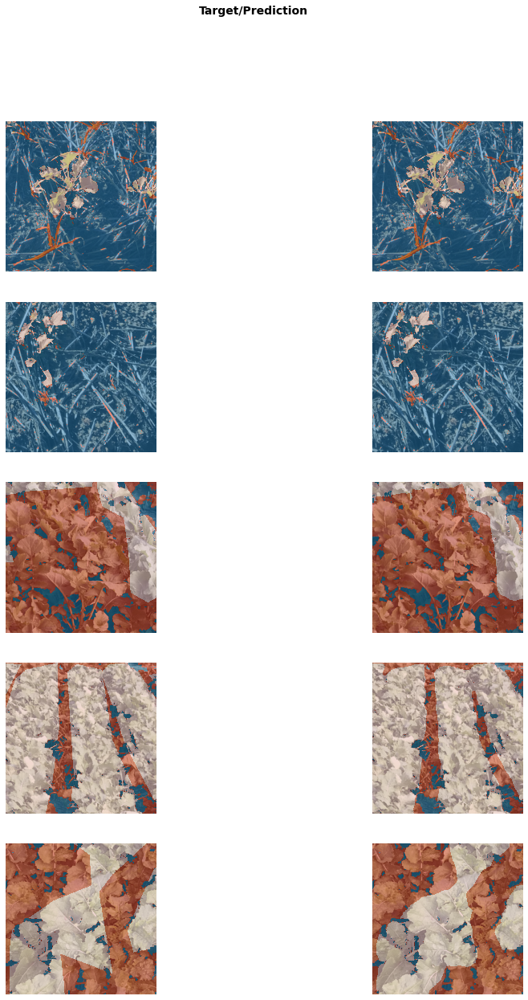

In [9]:
learn.show_results(max_n=10, figsize=(15,20))

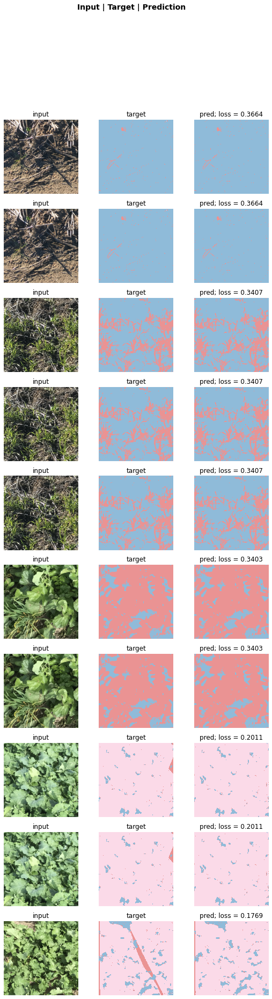

In [10]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

# KFOLD - 5-fold-val Resnet34 augmentation

In [11]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [12]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= [*aug_transforms(do_flip=True, flip_vert=True,
                 max_rotate=30.0, min_zoom=1.0,
                 max_zoom=1.5, max_lighting=0.5,
                 max_warp=0.2, p_affine=0.75,
                 p_lighting=0.75, xtra_tfms=None,
                 size = 500, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=False,
                 min_scale=1.0)])

# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=5)
    
    learn = unet_learner(dls, 
                     resnet34,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                    fname='unet34_kfold_aug', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold"
    with open(f"{path}unet34_kfold_aug.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.656968,4.011586,0.800830,4.485718,19:28


Better model found at epoch 0 with dice_multi value: 0.8008295736711029.


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,4.210302,3.579149,0.831047,4.983993,20:18
1,3.974246,3.365260,0.844408,5.513014,20:18
2,3.821991,3.418614,0.832696,4.722589,20:20
3,3.708090,3.289999,0.849570,5.436395,20:17
4,3.616774,3.143673,0.857369,5.832886,20:22
5,3.629869,3.307454,0.851981,5.528114,20:19
6,3.583433,3.244795,0.854937,5.296086,20:22
7,3.457634,3.031317,0.860103,5.612681,20:24
8,3.532119,3.208327,0.858303,5.265626,19:59
9,3.556677,2.971381,0.869053,5.919206,20:04


Better model found at epoch 0 with dice_multi value: 0.8310474543823263.
Better model found at epoch 1 with dice_multi value: 0.8444081487908308.
Better model found at epoch 3 with dice_multi value: 0.8495701894293172.
Better model found at epoch 4 with dice_multi value: 0.8573685721459611.
Better model found at epoch 7 with dice_multi value: 0.8601026841359779.
Better model found at epoch 9 with dice_multi value: 0.8690531445344184.
Better model found at epoch 11 with dice_multi value: 0.8700470474430904.
Better model found at epoch 13 with dice_multi value: 0.8742648981538649.
Better model found at epoch 14 with dice_multi value: 0.8769463654474375.
No improvement since epoch 14: early stopping


In [13]:
with open(f"{path}unet34_kfold_aug.txt", "wb") as ot:
         pickle.dump(results, ot)

In [14]:
with open(f"{path}unet34_kfold_aug.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [2.887991189956665],
 'dice': [0.8732535067736823],
 'iou': [5.793575923368954]}

In [15]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/unet34_kfold_aug.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

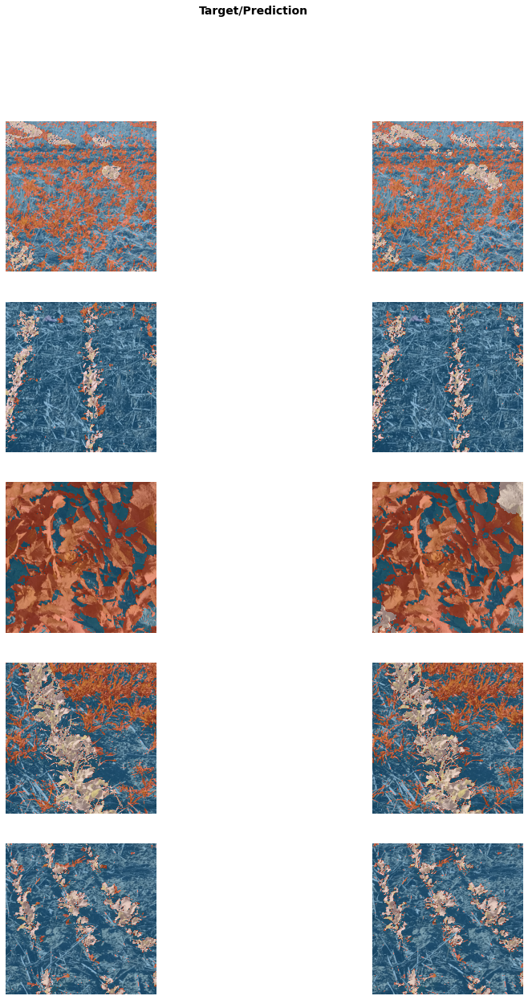

In [16]:
learn.show_results(max_n=10, figsize=(15,20))

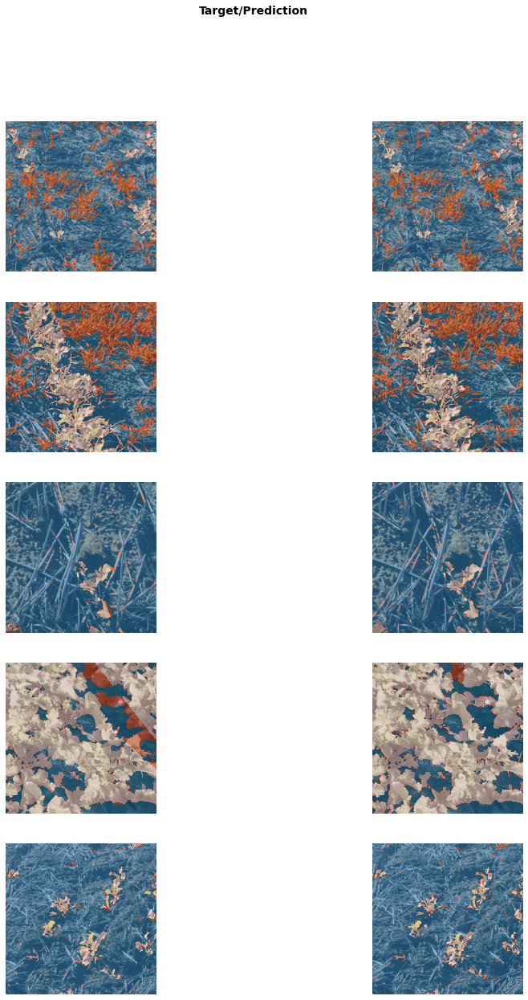

In [17]:
learn.show_results(max_n=10, figsize=(15,20))

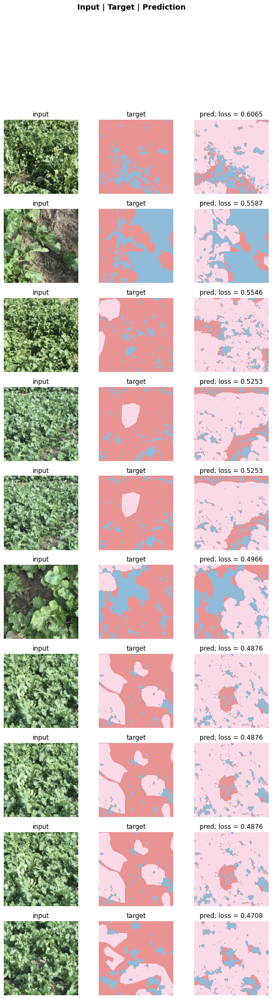

In [18]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

# VGG-16 AUG

In [3]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [12]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= [*aug_transforms(do_flip=True, flip_vert=True,
                 max_rotate=30.0, min_zoom=1.0,
                 max_zoom=1.5, max_lighting=0.5,
                 max_warp=0.2, p_affine=0.75,
                 p_lighting=0.75, xtra_tfms=None,
                 size = 224, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=False,
                 min_scale=1.0)])

# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=4)
    
    learn = unet_learner(dls, 
                     vgg16_bn,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                    fname='vgg16_kfold_aug', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold"
    with open(f"{path}vgg16_kfold_aug.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time


RuntimeError: CUDA out of memory. Tried to allocate 1.92 GiB (GPU 0; 15.90 GiB total capacity; 12.57 GiB already allocated; 1.83 GiB free; 13.01 GiB reserved in total by PyTorch)

In [5]:
with open(f"{path}vgg16_kfold_aug.txt", "wb") as ot:
         pickle.dump(results, ot)

In [6]:
with open(f"{path}vgg16_kfold_aug.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [2.589872360229492],
 'dice': [0.8627352102119032],
 'iou': [5.763233847078159]}

In [7]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/vgg16_kfold_aug.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

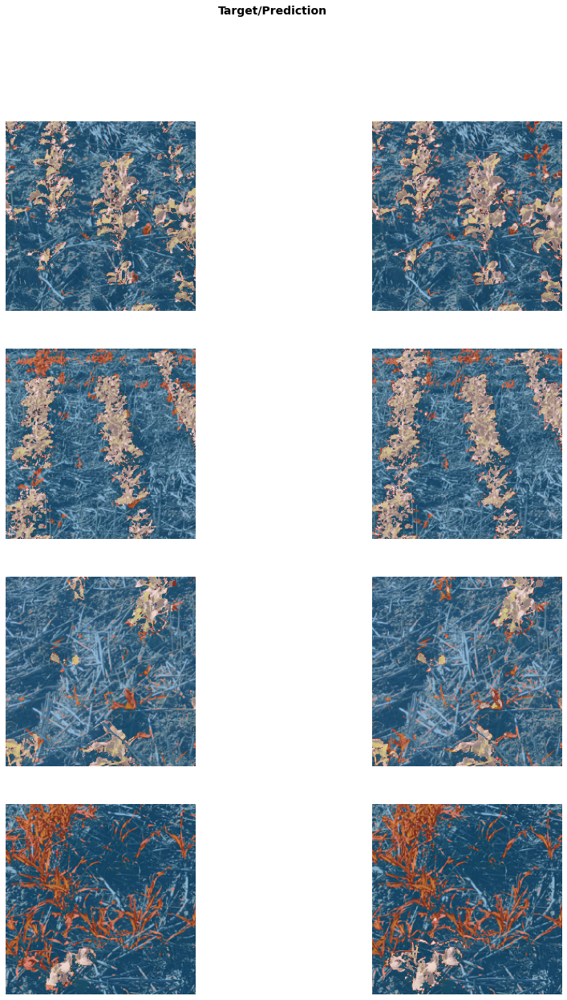

In [8]:
learn.show_results(max_n=10, figsize=(15,20))

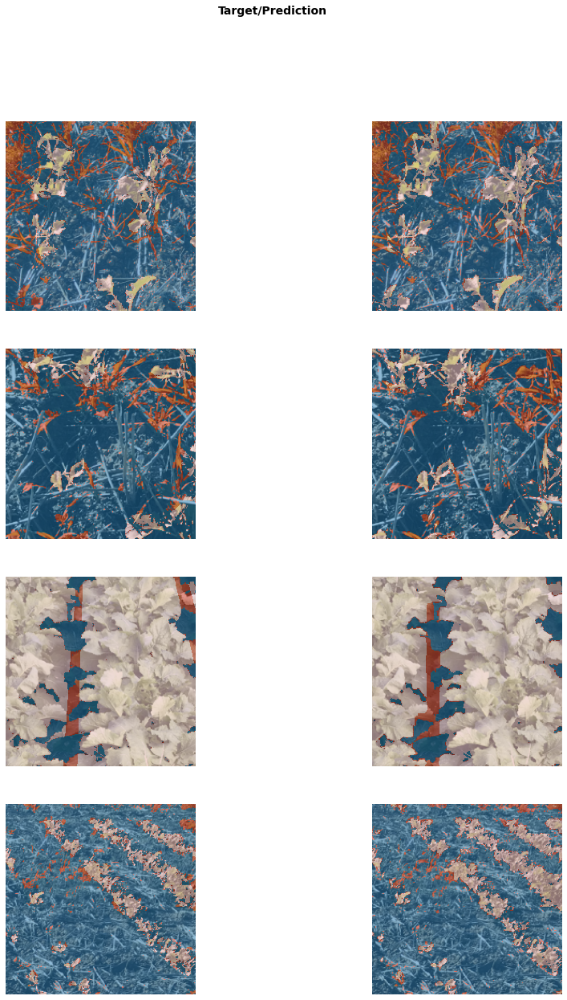

In [9]:
learn.show_results(max_n=10, figsize=(15,20))

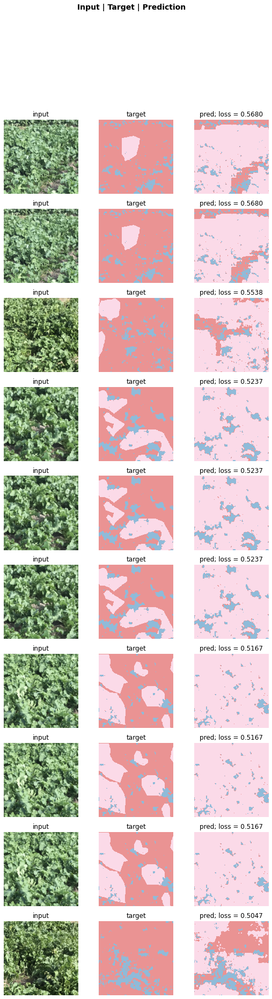

In [10]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

# VGG-16

In [3]:
def label_func(fn):

    path_mask = Path("/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/images_labels_new")
    #return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"
    return path_mask/f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [4]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold')

#define the valid idx
#a = get_image_files(path, folders=("0","1", "2", "3", "4"))
#valid_idx = mask2idxs([i.parent.stem == "0" for i in a])

results = {"val_loss":[],
          "dice":[],
          "iou":[]}


# load the data
for i in range(1):
    
    weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=KfoldSplitter(valid_pct=0.2, seed=100),
                  batch_tfms= [*aug_transforms(do_flip=False, flip_vert=False,
                 max_rotate=0.0, min_zoom=0.0,
                 max_zoom=0, max_lighting=0.0,
                 max_warp=0.0, p_affine=0.0,
                 p_lighting=0, xtra_tfms=None,
                 size = 224, mode='bilinear',
                 pad_mode='reflection', align_corners=True, batch=True,
                 min_scale=1.0)])
# create the data loader
    dls= weedt.dataloaders(path, folders=("0","1", "2", "3", "4") , path=path, bs=4)
    
    learn = unet_learner(dls, 
                     vgg16_bn,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     #lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp32()

    learn.fine_tune(300, 0.001,cbs = [EarlyStoppingCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                        patience=3, reset_on_fit=True),SaveModelCallback (monitor='dice_multi', comp=None, min_delta=0.0005,
                    fname='vgg16_kfold', every_epoch=False, at_end=True,
                    with_opt=True, reset_on_fit=True)])

# returns the [val loss, Dice_multi, Jaccard's index]
    results["val_loss"].append(learn.validate()[0])
    results["dice"].append(learn.validate()[1])
    results["iou"].append(learn.validate()[2])
    
    path = "/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold"
    with open(f"{path}vgg16_kfold.txt", "wb") as ot:
        pickle.dump(results, ot)

epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,3.138709,3.096162,0.817616,5.405666,21:13


Better model found at epoch 0 with dice_multi value: 0.8176155405299864.


epoch,train_loss,valid_loss,dice_multi,jaccard_coeff,time
0,2.431604,2.462266,0.865476,6.014546,21:47
1,2.218608,2.193438,0.885845,6.081465,21:48
2,2.047327,2.052104,0.895457,6.190470,21:50
3,1.902107,1.937408,0.904151,6.280148,21:48
4,1.809500,1.838724,0.909639,6.309340,21:49
5,1.815147,1.778716,0.913388,6.310816,21:49
6,1.703057,1.740556,0.916959,6.423495,21:49
7,1.631505,1.669930,0.920412,6.462597,21:50
8,1.623641,1.630099,0.924032,6.569284,21:50
9,1.606656,1.595728,0.925400,6.434098,21:50


Better model found at epoch 0 with dice_multi value: 0.8654763641265708.
Better model found at epoch 1 with dice_multi value: 0.8858449829164554.
Better model found at epoch 2 with dice_multi value: 0.8954568574132772.
Better model found at epoch 3 with dice_multi value: 0.9041514437129815.
Better model found at epoch 4 with dice_multi value: 0.9096392207295563.
Better model found at epoch 5 with dice_multi value: 0.9133876146727924.
Better model found at epoch 6 with dice_multi value: 0.9169585136126567.
Better model found at epoch 7 with dice_multi value: 0.9204124857946461.
Better model found at epoch 8 with dice_multi value: 0.9240322304406474.
Better model found at epoch 9 with dice_multi value: 0.9254003744946407.
Better model found at epoch 10 with dice_multi value: 0.9284926620011245.
Better model found at epoch 11 with dice_multi value: 0.929579534024918.
Better model found at epoch 13 with dice_multi value: 0.9326510484208584.
Better model found at epoch 14 with dice_multi va

In [5]:
with open(f"{path}vgg16_kfold.txt", "wb") as ot:
         pickle.dump(results, ot)

In [6]:
with open(f"{path}vgg16_kfold.txt", 'rb') as f:
    loaded_dict = pickle.load(f)
loaded_dict

{'val_loss': [1.3749759197235107],
 'dice': [0.9383874312776416],
 'iou': [6.644752849097123]}

In [7]:
learn.export(fname='/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/kfold/models/vgg16_kfold.pkl',
                   pickle_module=pickle,
                   pickle_protocol=2)

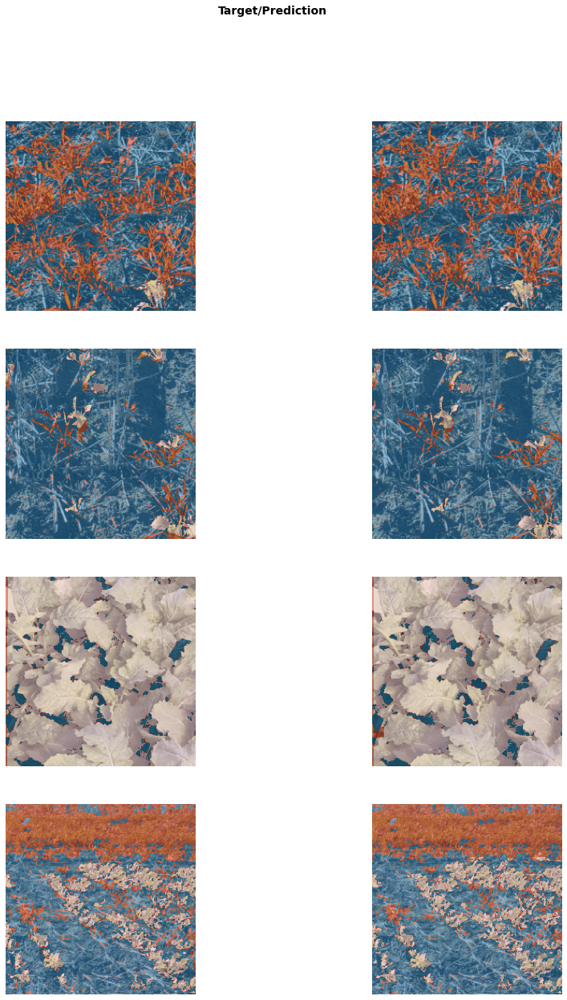

In [8]:
learn.show_results(max_n=10, figsize=(15,20))

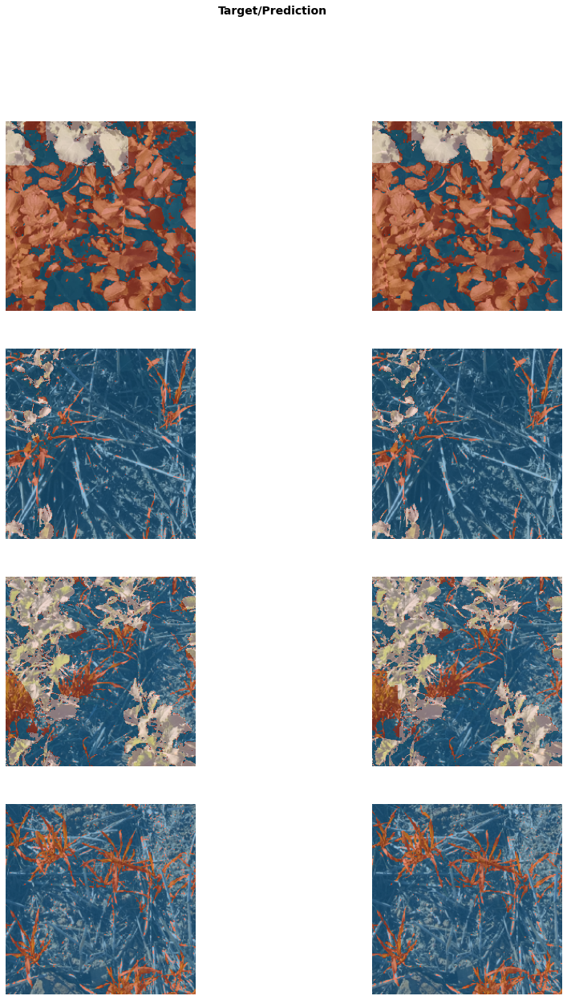

In [9]:
learn.show_results(max_n=10, figsize=(15,20))

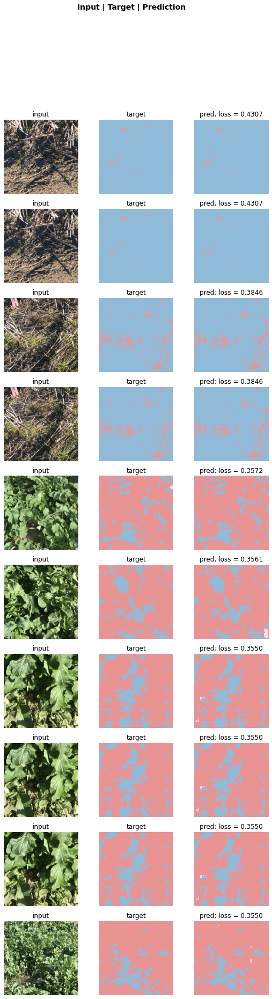

In [10]:
interp = SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

# Getting results after kfold test

In [4]:
def label_func(fn):
    path_mask = Path("/data/weed_data/kfold_5ds/labels")
    return path_mask/f"{fn.parent.stem}"/ f"{fn.stem.replace('image', 'mask')}{fn.suffix}"

In [5]:
# Prepare datasets
# Load the data
codes = np.loadtxt("/group/pawsey0149/mmckay/singularity/codes.txt", dtype='str')
path = Path('/group/pawsey0149/mmckay/singularity/train_val_sets_PNG/split')

#define the valid idx
a = get_image_files(path, folders=("split_0","split_1", "split_2", "split_3", "split_4"))
valid_idx = mask2idxs([i.parent.stem == "1" for i in a])

# load the data
weedt = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                  get_items = get_image_files,
                  get_y = label_func,
                  splitter=IndexSplitter(valid_idx),
                  batch_tfms=Normalize)

# create the data loader
dls= weedt.dataloaders(path, folders=("1","2", "3", "4", "5"), path=path, bs=4)

/home/modanilevicz/.local/lib/python3.8/site-packages/torch/_tensor.py:1051: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)


In [6]:
# build the model
learn = unet_learner(dls,
                     resnet18,
                     n_out=3,
                     self_attention=True,
                     normalize=True,
                     pretrained=True,
                     loss_func=DiceLoss(),
                     opt_func=Adam,
                     lr= 0.001,
                     wd=None,
                     metrics=[DiceMulti, JaccardCoeff]).to_fp16()

In [7]:
learn.load('/data/weed_data/model_weights/unet18_1fold_2round')

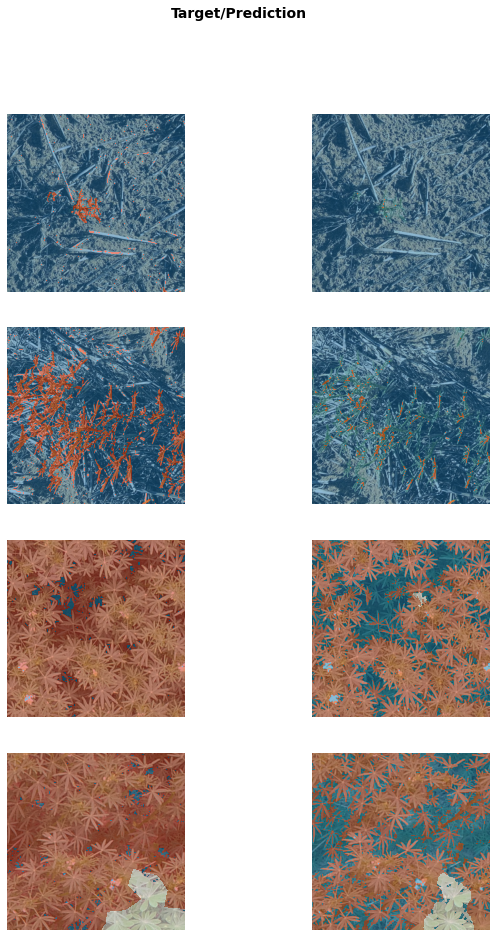

In [9]:
learn.show_results(max_n=6, figsize=(10,15))